In [1]:
%load_ext jupyter_black
%reload_ext autoreload
%autoreload 2

In [2]:
# Import libraries
import pandas as pd
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

plt.style.use("ggplot")
import os
import requests
import seaborn as sns

In [3]:
from functions.drees import DREES

In [4]:
# Init -> this create required folders
drees = DREES()

In [5]:
drees.get_covid_dataset_list()

['covid-19-avant-amelioration-resultats-nationaux-issus-des-appariements-entre-si-',
 'covid-19-anciens-resultats-par-age-issus-des-appariements-entre-si-vic-si-dep-et',
 'covid-19-avant-amelioration-resultats-regionaux-issus-des-appariements-entre-si-',
 'covid-19-anciens-resultats-nationaux-issus-des-appariements-entre-si-vic-si-dep-',
 'covid-19-resultats-issus-des-appariements-entre-si-vic-si-dep-et-vac-si',
 'covid-19-resultats-regionaux-issus-des-appariements-entre-si-vic-si-dep-et-vac-s',
 'covid-19-avant-amelioration-resultats-par-age-issus-des-appariements-entre-si-vi',
 'covid-19-resultats-par-age-issus-des-appariements-entre-si-vic-si-dep-et-vac-si',
 'covid-19-anciens-resultats-regionaux-issus-des-appariements-entre-si-vic-si-dep-']

In [6]:
[ds for ds in drees.get_covid_dataset_list() if "age" in ds]

['covid-19-anciens-resultats-par-age-issus-des-appariements-entre-si-vic-si-dep-et',
 'covid-19-avant-amelioration-resultats-par-age-issus-des-appariements-entre-si-vi',
 'covid-19-resultats-par-age-issus-des-appariements-entre-si-vic-si-dep-et-vac-si']

In [7]:
drees.download_data(force_reload=False)

In [8]:
ds_age, ds_region, ds = drees.create_datasets()

by_age


p:\COVID\01_DREES\functions\drees.py:100: FutureWarning: pivot_table dropped a column because it failed to aggregate. This behavior is deprecated and will raise in a future version of pandas. Select only the columns that can be aggregated.
  df = pd.pivot_table(


by_region


p:\COVID\01_DREES\functions\drees.py:100: FutureWarning: pivot_table dropped a column because it failed to aggregate. This behavior is deprecated and will raise in a future version of pandas. Select only the columns that can be aggregated.
  df = pd.pivot_table(
p:\COVID\01_DREES\functions\drees.py:100: FutureWarning: pivot_table dropped a column because it failed to aggregate. This behavior is deprecated and will raise in a future version of pandas. Select only the columns that can be aggregated.
  df = pd.pivot_table(


national


# Data analysis and observation

## National data

In [9]:
ds = xr.open_dataarray("data/ds_national.nc")
ds = ds.resample(
    date="W"
).mean()  # weekly resampling to filter week-end artefact on death registered on monday
ds

<xarray.DataArray (version: 3, variable: 13, vac_statut: 18, date: 106)>
array([[[[           nan,            nan,            nan, ...,
                     nan,            nan,            nan],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
                     nan,            nan,            nan],
         [           nan,            nan,            nan, ...,
                     nan,            nan,            nan],
         ...,
         [6.24285714e+00, 6.97428571e+00, 4.82857143e+00, ...,
                     nan,            nan,            nan],
         [3.57142857e-02, 0.00000000e+00, 2.85714286e-03, ...,
                     nan,            nan,            nan],
         [           nan,            nan,            nan, ...,
                     nan,            nan,            nan]],

        [[           nan,            nan,            nan, ...,
                     nan,            nan,            nan],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
                     nan,            nan,            nan],
         [           nan,            nan,            nan, ...,
                     nan,            nan,            nan],
...
         [6.57428571e+00, 5.53142857e+00, 3.03428571e+00, ...,
          1.57142857e-02, 5.71428571e-03, 1.44285714e-01],
         [4.26571429e+00, 2.88857143e+00, 1.23857143e+00, ...,
          0.00000000e+00, 1.42857143e-03, 0.00000000e+00],
         [           nan,            nan,            nan, ...,
                     nan,            nan,            nan]],

        [[           nan,            nan,            nan, ...,
          5.38857143e+00, 3.81428571e+00, 2.98714286e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          1.71428571e-02, 0.00000000e+00, 7.14285714e-03],
         [           nan,            nan,            nan, ...,
          4.28571429e-03, 1.44285714e-01, 2.85714286e-03],
         ...,
         [4.58714286e+00, 3.70000000e+00, 2.51285714e+00, ...,
          8.57142857e-03, 4.28571429e-03, 1.42857143e-03],
         [3.16285714e+00, 2.07857143e+00, 6.24285714e-01, ...,
          0.00000000e+00, 1.42857143e-03, 0.00000000e+00],
         [           nan,            nan,            nan, ...,
                     nan,            nan,            nan]]]])
Coordinates:
  * variable    (variable) <U23 'dc' 'dc_pcr' 'effectif' ... 'sc' 'sc_pcr'
  * vac_statut  (vac_statut) <U50 'Complet - avec 1 rappel de 6 mois ou plus'...
  * version     (version) <U9 'avant' 'anciens' 'resultats'
  * date        (date) datetime64[ns] 2021-06-06 2021-06-13 ... 2023-06-11

### Effectif

There is no more effectif data in the most recent dataset. This is really problematic as it prevent from normalising population group and compare them. Also between the first and second dataset the 7 days time shift was removed. 

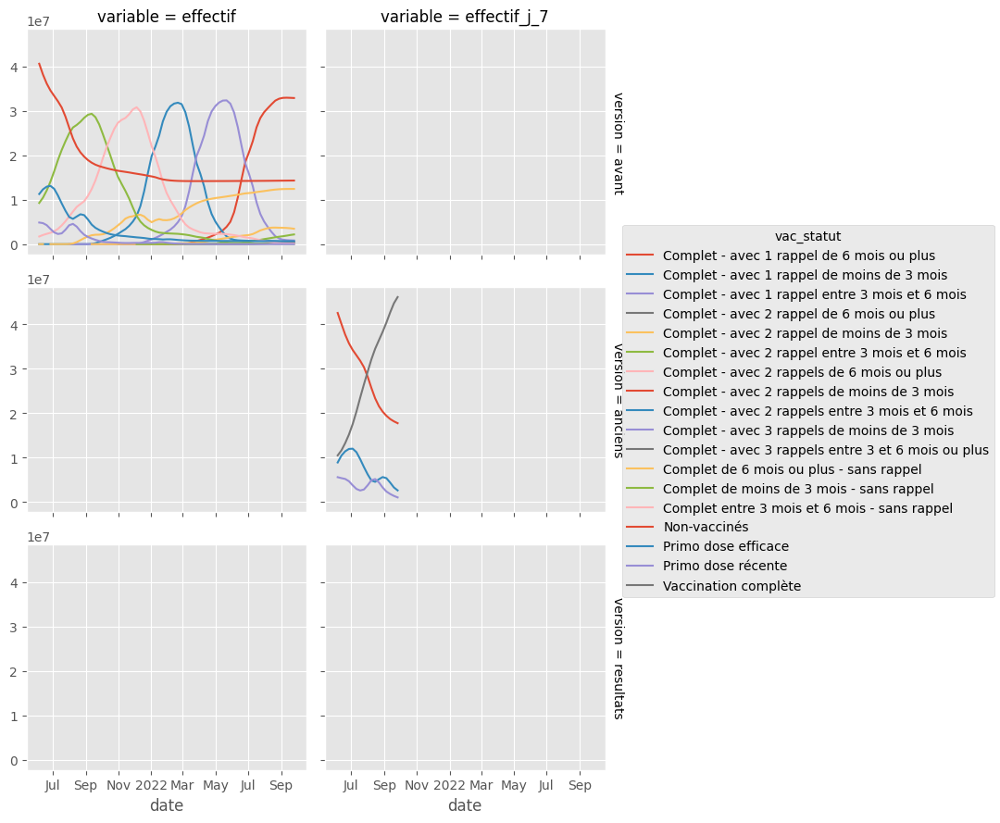

In [10]:
ds.sel(variable=["effectif", "effectif_j_7"]).plot(
    col="variable", hue="vac_statut", row="version"
)

In [11]:
ds_grouped = drees.group_vac_statut(ds)

C:\Users\romai\AppData\Local\Temp\ipykernel_15332\2502136506.py:5: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  .drop(["variable", "version"])


Text(0.5, 1.0, 'Evolution of population vaccinal status')

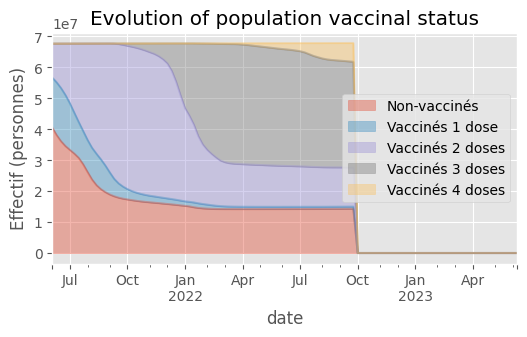

In [12]:
df_effectif = (
    ds_grouped.sel(version="avant")
    .sel(variable="effectif")
    .to_dataset("vac_statut")
    .drop(["variable", "version"])
    .to_dataframe()
)
fig, ax = plt.subplots(figsize=(6, 3))
df_effectif.plot(kind="area", stacked=True, alpha=0.4, ax=ax)
ax.set_ylabel("Effectif (personnes)")
ax.set_title("Evolution of population vaccinal status")

In [13]:
from functions.drees import calculate_vax_rollout

In [14]:
df_vax_rollout = calculate_vax_rollout(
    df_effectif,
    list_vac_status=[
        "Non-vaccinés",
        "Vaccinés 1 dose",
        "Vaccinés 2 doses",
        "Vaccinés 3 doses",
        "Vaccinés 4 doses",
    ],
)
df_vax_rollout.head()

3
2
1


,4,3,2,1
date,,,,
2021-06-06,NaN,NaN,NaN,NaN
2021-06-13,0.0,1.000000,1.520891e+06,2.436006e+06
2021-06-20,0.0,1.000000,1.871142e+06,2.026900e+06
2021-06-27,0.0,0.000000,2.248881e+06,1.568096e+06
2021-07-04,0.0,2.142857,2.675166e+06,1.226649e+06


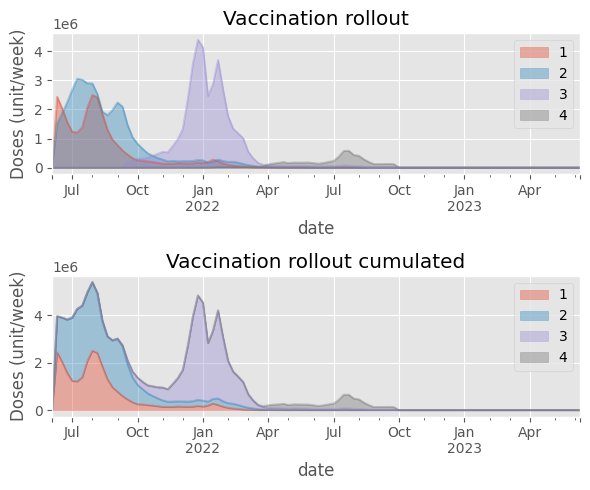

In [15]:
fig, ax = plt.subplots(2, 1, figsize=(6, 5))
df_vax_rollout[[1, 2, 3, 4]].plot(ax=ax[0], kind="area", stacked=False, alpha=0.4)
df_vax_rollout[[1, 2, 3, 4]].plot(ax=ax[1], kind="area", stacked=True, alpha=0.4)
ax[0].set_title("Vaccination rollout")
ax[0].set_ylabel("Doses (unit/week)")
ax[1].set_title("Vaccination rollout cumulated")
ax[1].set_ylabel("Doses (unit/week)")
plt.tight_layout()

In [16]:
df_vax_rollout[[1, 2, 3, 4]].to_pickle("data/df_vax_rollout.pkl")

### Testing

In [17]:
list_test_related = [
    "nb_pcr",
    "nb_pcr0",
    "nb_pcr_sympt",
    "nb_pcr_sympt0",
]

- Ancient dataset overestimated number of test for unvaxxed, and understimated for vaxxed.
- No differences between avant and resultat

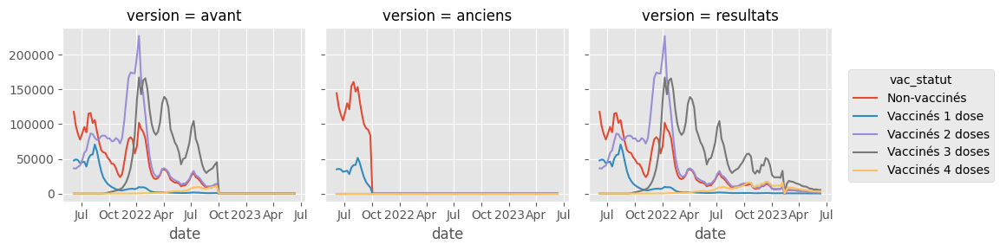

In [18]:
ds_grouped.sel(variable="nb_pcr").plot(col="version", hue="vac_statut")

- Too much positive test among the vaxxed for vaccins being efficient againt the infection.

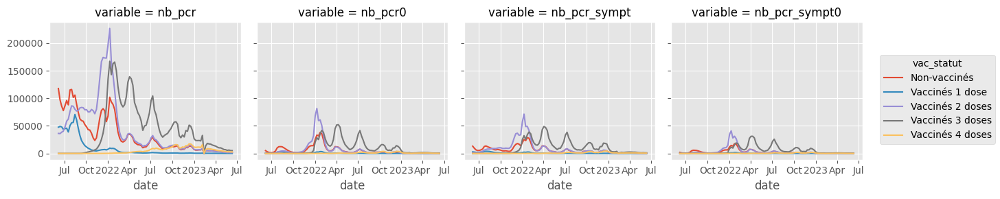

In [19]:
ds_grouped.sel(variable=list_test_related).sel(version="resultats").plot(
    hue="vac_statut", col="variable"
)

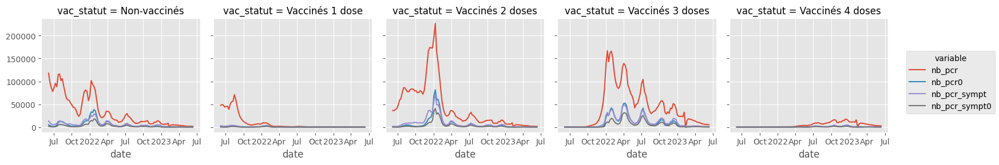

In [20]:
ds_grouped.sel(variable=list_test_related).sel(version="resultats").plot(
    col="vac_statut", hue="variable"
)

- Positivity rate (calculated per tested done, and not person) among the vaxxed is lower during the first wave, and then becomes higher.

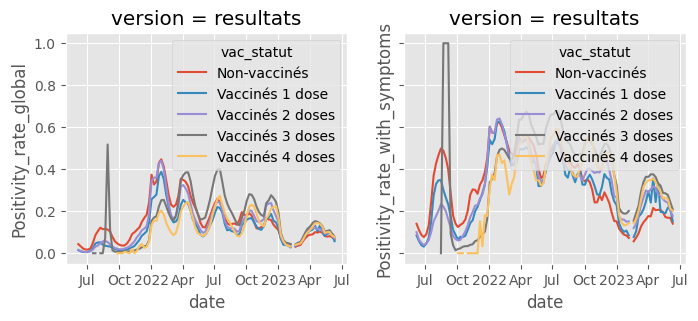

In [21]:
dsp = (
    ds_grouped.sel(variable=list_test_related)
    .sel(version="resultats")
    .to_dataset("variable")
)
dsp["Positivity_rate_global"] = dsp.nb_pcr0 / dsp.nb_pcr
dsp["Positivity_rate_with_symptoms"] = dsp.nb_pcr_sympt0 / dsp.nb_pcr_sympt
fig, ax = plt.subplots(1, 2, sharey=True, sharex=True, figsize=(8, 3))
for i, variable in enumerate(
    ["Positivity_rate_global", "Positivity_rate_with_symptoms"]
):
    dsp[variable].plot(hue="vac_statut", ax=ax[i])

In [22]:
ds_grouped_normalised = ds_grouped.sel(version="avant") / ds_grouped.sel(
    version="avant"
).sel(variable="effectif")

(0.0, 0.008)

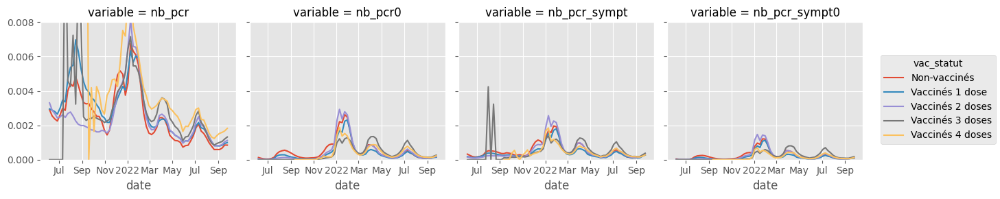

In [23]:
ds_grouped_normalised.sel(variable=list_test_related).plot(
    hue="vac_statut",
    col="variable",
)
plt.ylim(0, 0.008)

(0.0, 0.01)

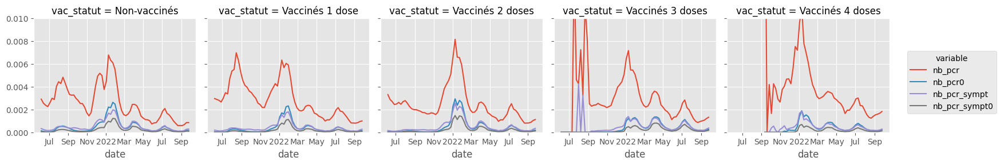

In [24]:
ds_grouped_normalised.sel(variable=list_test_related).plot(
    col="vac_statut", hue="variable"
)
plt.ylim(0, 0.010)

### Hospitalisation, Intensive Care and Death 

In [25]:
list_indicator = ["hc", "sc", "dc"]

In [26]:
indicator = list_indicator[0]
indicator

'hc'

- Overestimation of the unvaxxed hospitalisation.

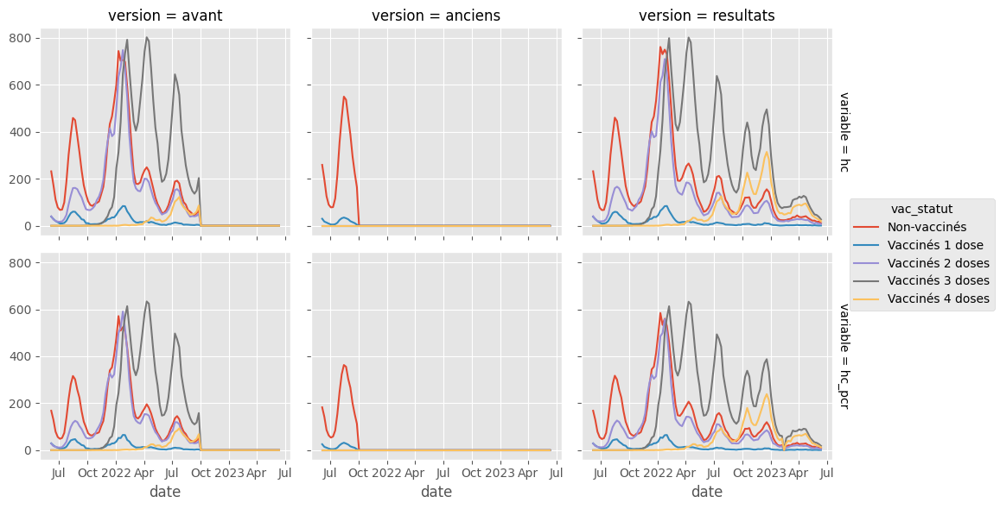

In [27]:
ds_grouped.sel(variable=[indicator, indicator + "_pcr"]).plot(
    col="version", hue="vac_statut", row="variable"
)

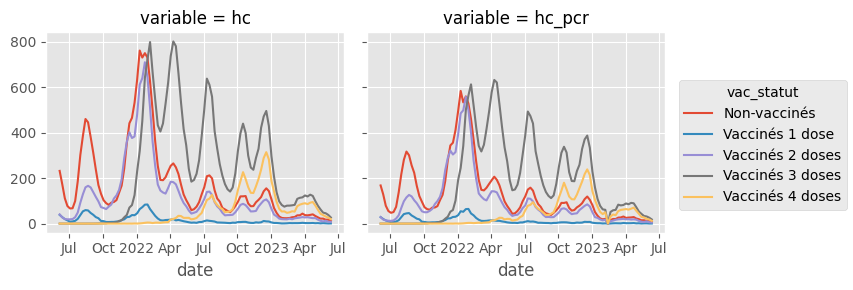

In [28]:
ds_grouped.sel(variable=[indicator, indicator + "_pcr"]).sel(version="resultats").plot(
    hue="vac_statut", col="variable"
)

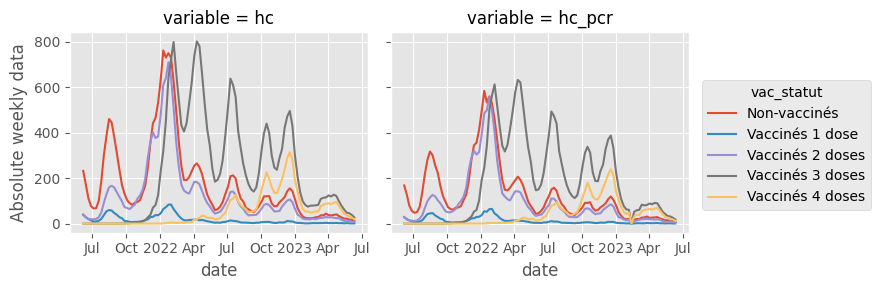

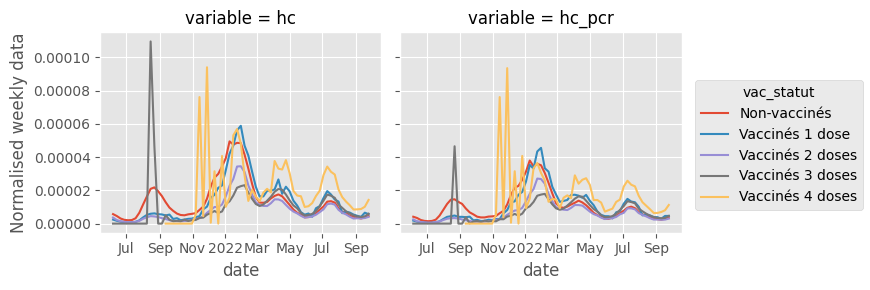

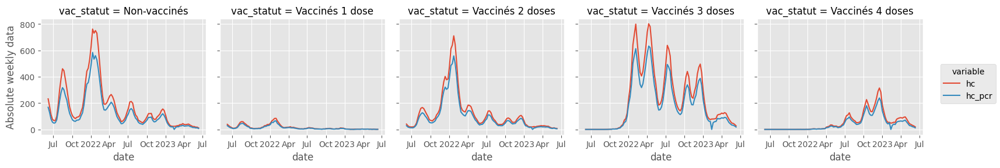

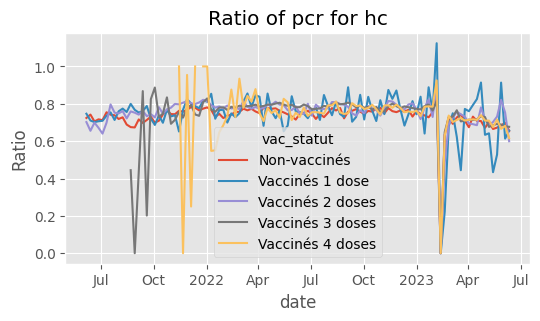

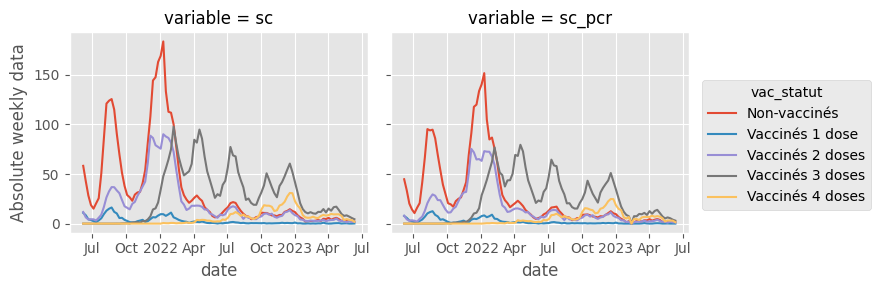

...

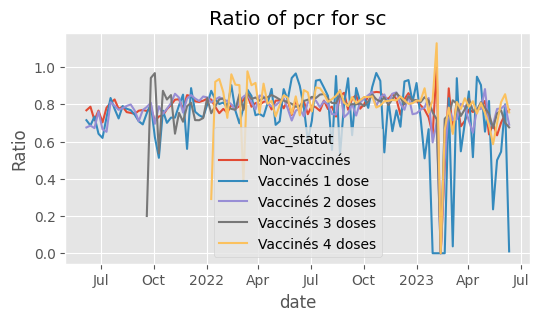

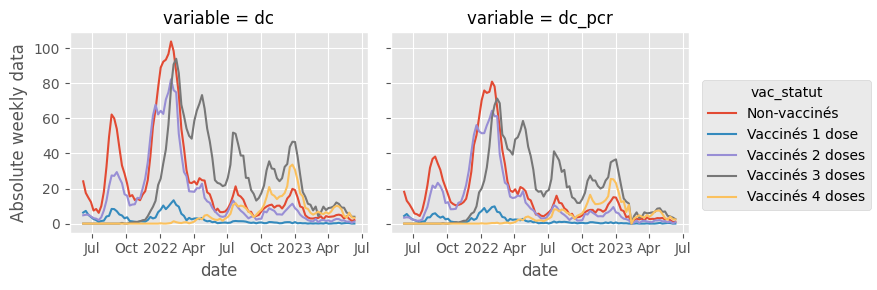

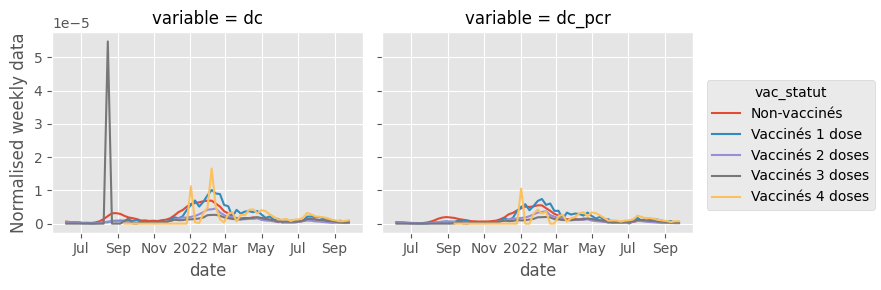

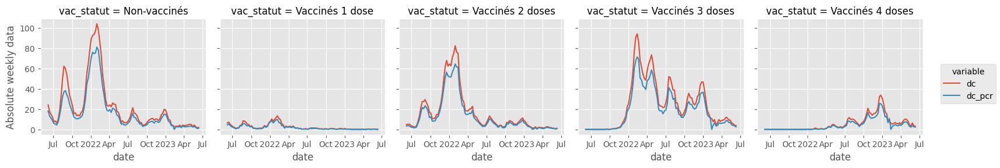

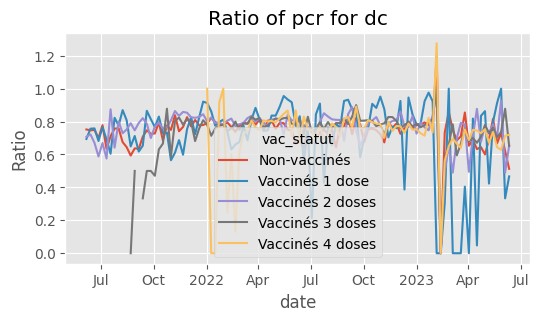

In [29]:
for indicator in list_indicator:
    fig = (
        ds_grouped.sel(variable=[indicator, indicator + "_pcr"])
        .sel(version="resultats")
        .plot(hue="vac_statut", col="variable")
    )
    fig.set_ylabels("Absolute weekly data")

    fig = ds_grouped_normalised.sel(variable=[indicator, indicator + "_pcr"]).plot(
        hue="vac_statut", col="variable"
    )
    fig.set_ylabels("Normalised weekly data")

    fig = (
        ds_grouped.sel(variable=[indicator, indicator + "_pcr"])
        .sel(version="resultats")
        .plot(col="vac_statut", hue="variable")
    )
    fig.set_ylabels("Absolute weekly data")

    fig, ax = plt.subplots(figsize=(6, 3))
    (
        ds_grouped.sel(version="resultats").sel(variable=indicator + "_pcr")
        / ds_grouped.sel(version="resultats").sel(variable=indicator)
    ).plot(hue="vac_statut", ax=ax)
    ax.set_title(f"Ratio of pcr for {indicator}")
    ax.set_ylabel(f"Ratio")

### Focus on changes for unvaccinated with version

In [30]:
ds_binary = drees.group_vac_statut(ds, binary=True)
ds_binary

<xarray.DataArray (vac_statut: 2, version: 3, variable: 13, date: 106)>
array([[[[2.44500000e+01, 1.75628571e+01, 1.49257143e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [1.82071429e+01, 1.29971429e+01, 1.13657143e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [4.05765211e+07, 3.81433740e+07, 3.61193262e+07, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         ...,
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [5.84485714e+01, 4.22842857e+01, 2.82700000e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [4.48742857e+01, 3.30900000e+01, 2.02585714e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[2.74285714e+01, 2.32857143e+01, 1.95714286e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [1.94285714e+01, 1.70000000e+01, 1.41428571e+01, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
...
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [1.45714286e+01, 7.85714286e+00, 4.71428571e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         [1.10000000e+01, 6.00000000e+00, 3.71428571e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

        [[1.10625000e+01, 1.22814286e+01, 1.01282143e+01, ...,
          1.48757143e+01, 9.30714286e+00, 9.25000000e+00],
         [7.74285714e+00, 9.11857143e+00, 7.23250000e+00, ...,
          1.07357143e+01, 7.18142857e+00, 6.09142857e+00],
         [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
         ...,
         [9.99985714e+01, 1.00001429e+02, 1.00001429e+02, ...,
          9.99914286e+01, 1.00001429e+02, 1.00007143e+02],
         [2.25542857e+01, 1.47114286e+01, 8.41428571e+00, ...,
          1.50742857e+01, 1.19685714e+01, 9.06285714e+00],
         [1.56671429e+01, 1.00928571e+01, 5.92142857e+00, ...,
          1.16657143e+01, 9.09857143e+00, 6.36285714e+00]]]])
Coordinates:
  * variable    (variable) <U23 'dc' 'dc_pcr' 'effectif' ... 'sc' 'sc_pcr'
  * version     (version) <U9 'avant' 'anciens' 'resultats'
  * date        (date) datetime64[ns] 2021-06-06 2021-06-13 ... 2023-06-11
  * vac_statut  (vac_statut) <U24 'Non-vaccinés' 'Vaccinés au moins 1 dose'

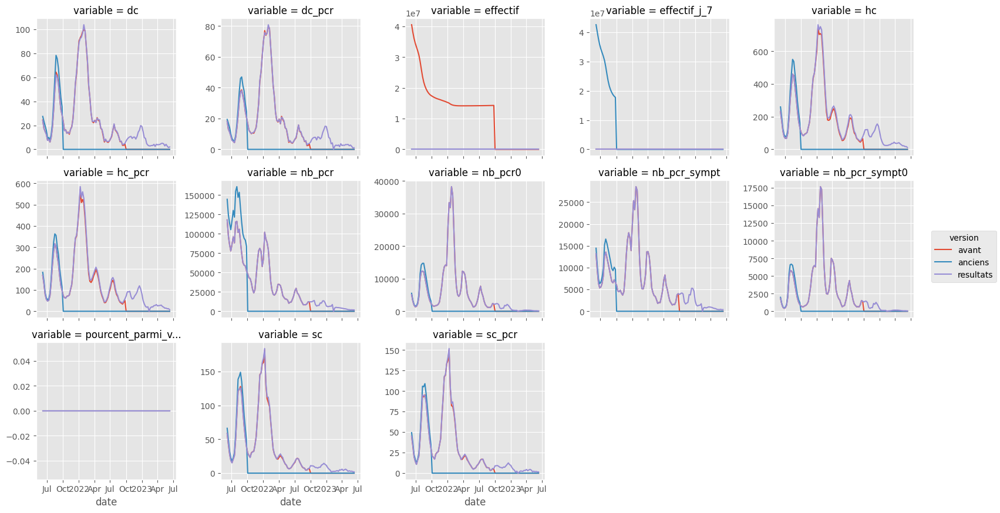

In [31]:
ds_binary.sel(vac_statut="Non-vaccinés").plot(
    hue="version", col="variable", col_wrap=5, sharey=False
)

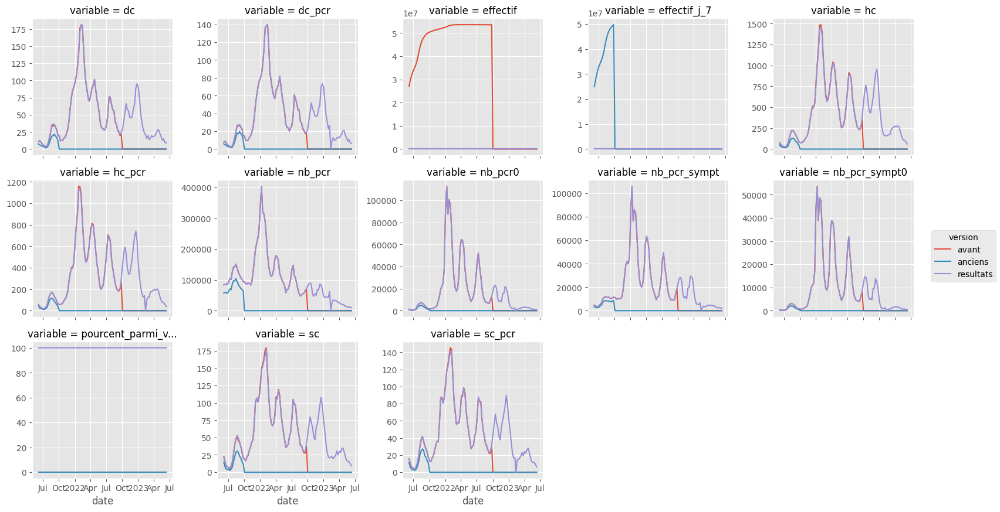

In [32]:
ds_binary.sel(vac_statut="Vaccinés au moins 1 dose").plot(
    hue="version", col="variable", col_wrap=5, sharey=False
)

- Initial overestimation of everything for unvaxxed, and underestimation for vaxxed!

## By age data

In [33]:
ds_age = xr.load_dataarray("data/ds_by_age.nc")
ds_age = ds_age.resample(date="W").mean()
ds_age_grouped = drees.group_vac_statut(ds_age)
ds_age_grouped_normalised = ds_age_grouped.sel(version="avant") / ds_age_grouped.sel(
    version="avant"
).sel(variable="effectif")

In [34]:
ds_age_grouped_binary = drees.group_vac_statut(ds_age, binary=True)
ds_age_grouped_normalised_binary = ds_age_grouped_binary.sel(
    version="avant"
) / ds_age_grouped_binary.sel(version="avant").sel(variable="effectif")

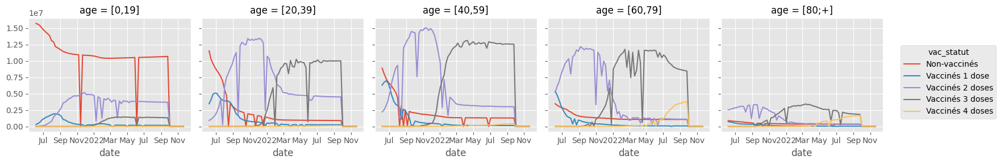

In [35]:
ds_age_grouped.sel(variable="effectif", version="avant").plot(
    col="age", hue="vac_statut"
)

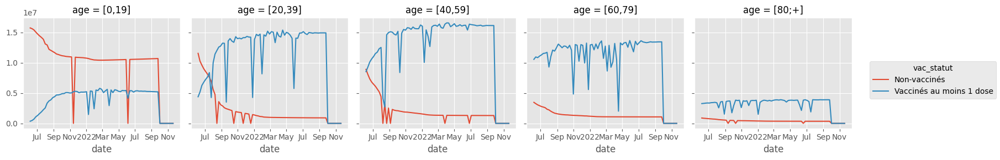

In [36]:
ds_age_grouped_binary.sel(variable="effectif", version="avant").plot(
    col="age", hue="vac_statut"
)

In [37]:
list_variables = [
    "dc",
    "dc_pcr",
    "dc_pcr_pour_covid",
    # "dc_pourcent_omicron",
    # "effectif",
    # "effectif_j_7",
    "hc",
    "hc_pcr",
    "hc_pcr_pour_covid",
    "hc_pourcent_omicron",
    "nb_pcr",
    "nb_pcr0",
    "nb_pcr_sympt",
    "nb_pcr_sympt0",
    "pcr_pourcent_omicron",
    "pcr_sympt_pourcent_omicron",
    "pourcent_parmi_vaccines",
    "sc",
    "sc_pcr",
    "sc_pcr_pour_covid",
    "sc_pourcent_omicron",
]

### Plot by number of dose

#### Sharey = True

c:\Users\romai\anaconda3\envs\python311\Lib\site-packages\xarray\plot\facetgrid.py:217: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(


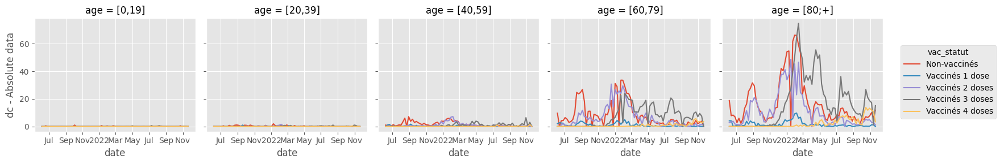

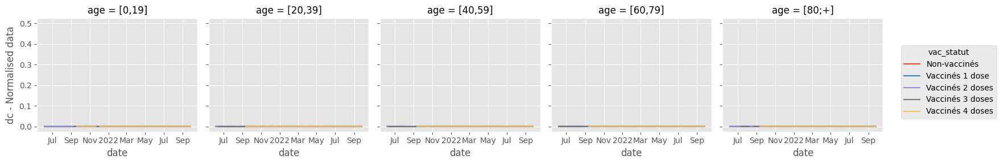

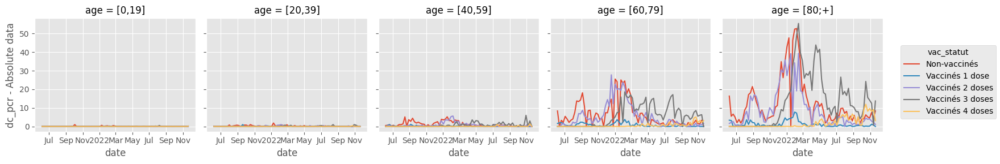

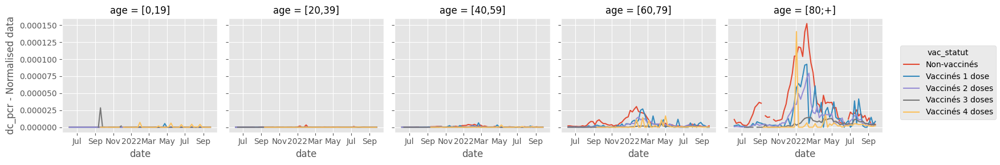

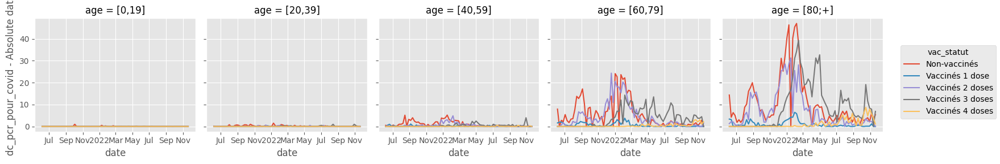

...

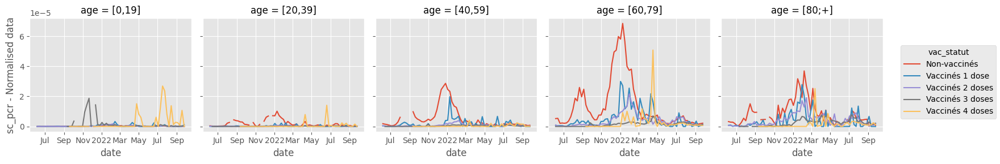

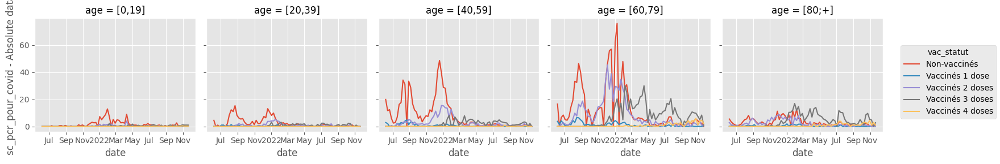

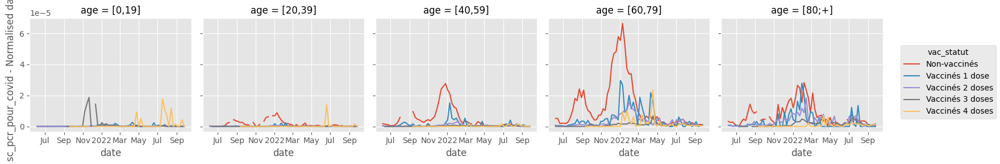

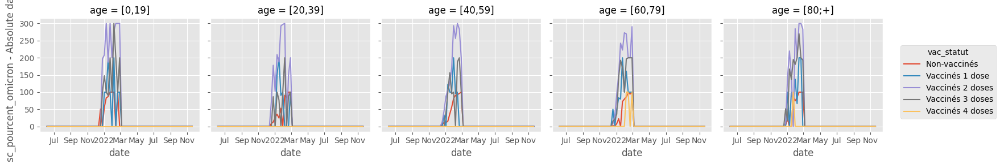

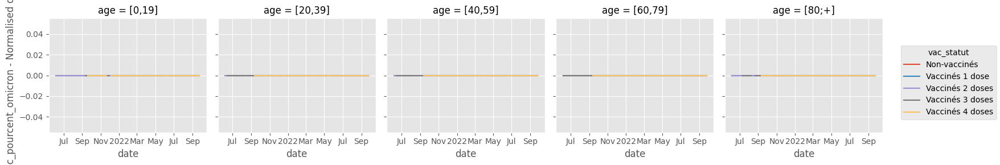

In [38]:
dsp = ds_age_grouped.sel(version="resultats").to_dataset("variable")
dsp2 = ds_age_grouped_normalised.to_dataset("variable")
for variable in list_variables:
    fig = dsp[variable].plot(hue="vac_statut", col="age")
    fig.set_ylabels(f"{variable} - Absolute data")
    fig = dsp2[variable].plot(hue="vac_statut", col="age")
    fig.set_ylabels(f"{variable} - Normalised data")

#### Sharey = False

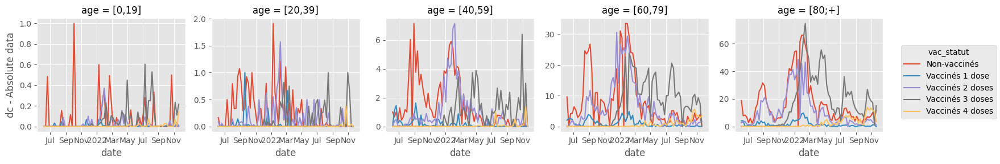

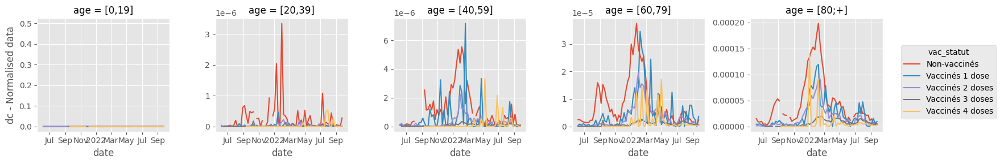

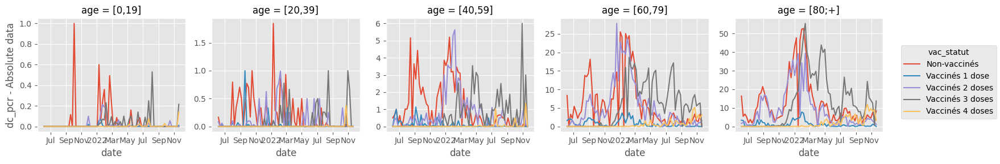

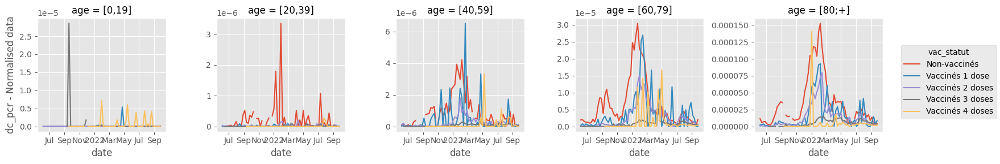

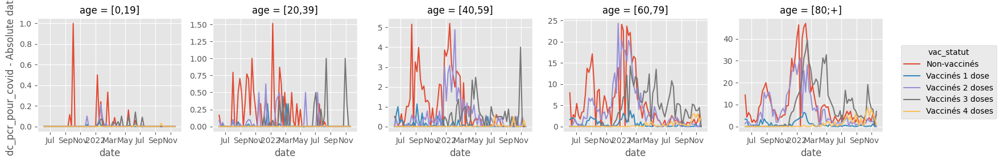

...

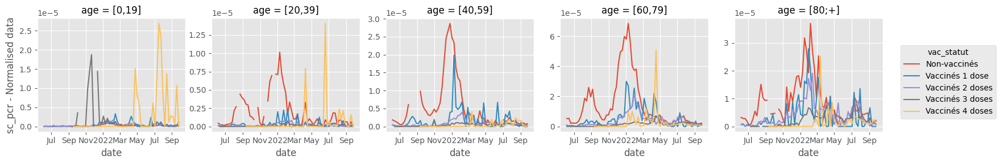

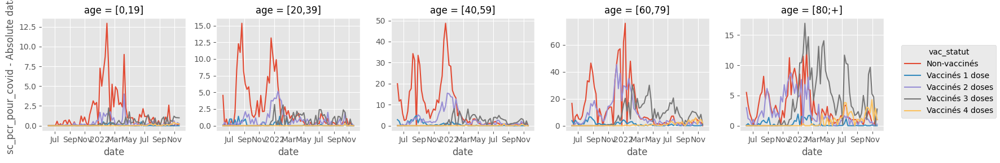

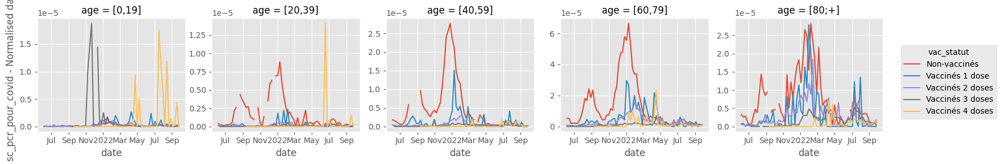

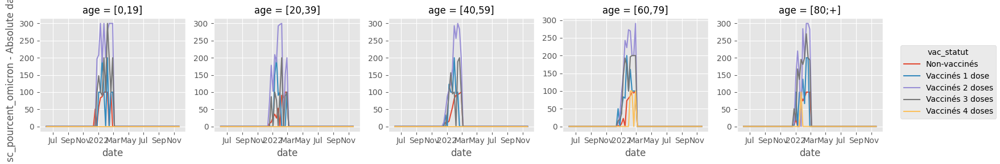

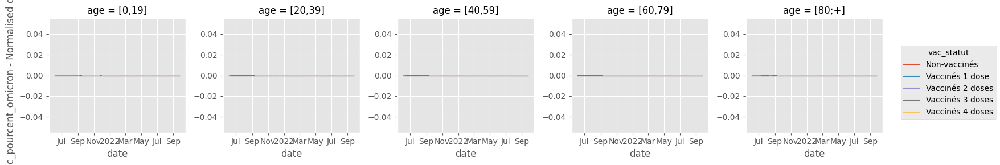

In [39]:
# Same but without sharey axis
dsp = ds_age_grouped.sel(version="resultats").to_dataset("variable")
dsp2 = ds_age_grouped_normalised.to_dataset("variable")
for variable in list_variables:
    fig = dsp[variable].plot(hue="vac_statut", col="age", sharey=False)
    fig.set_ylabels(f"{variable} - Absolute data")
    fig = dsp2[variable].plot(hue="vac_statut", col="age", sharey=False)
    fig.set_ylabels(f"{variable} - Normalised data")

### Vax or not

#### Sharey = False

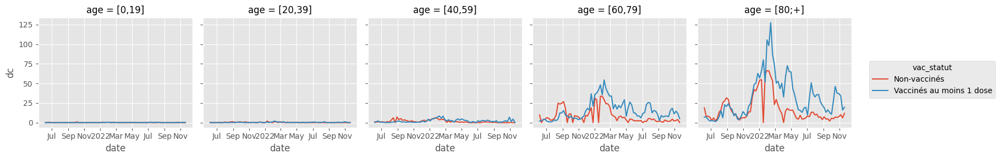

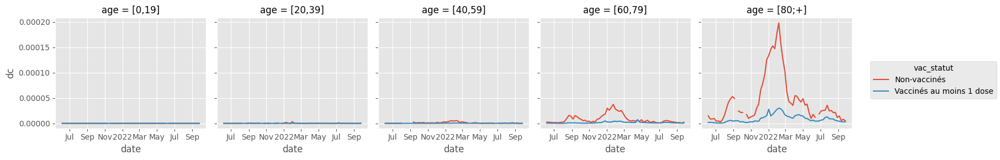

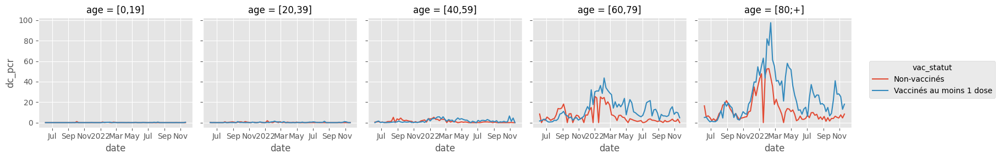

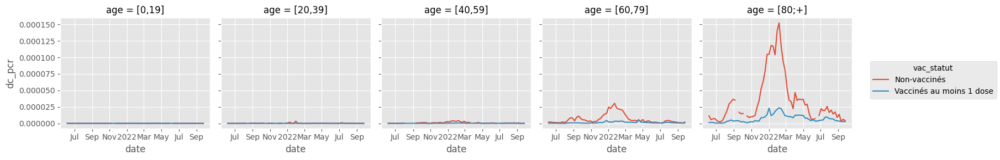

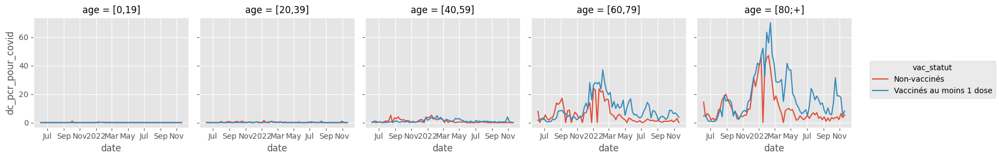

...

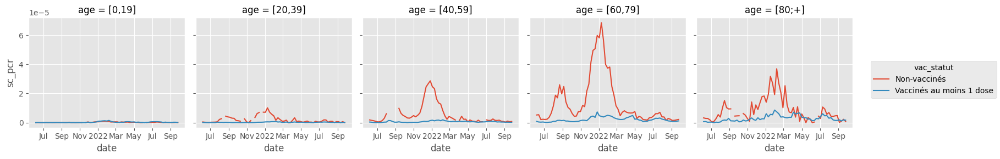

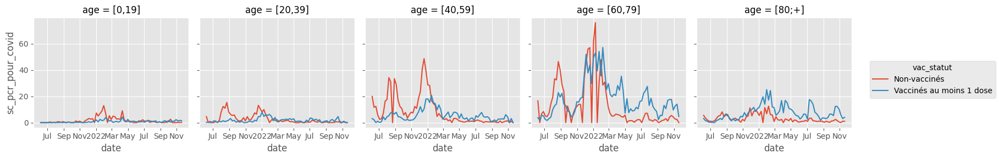

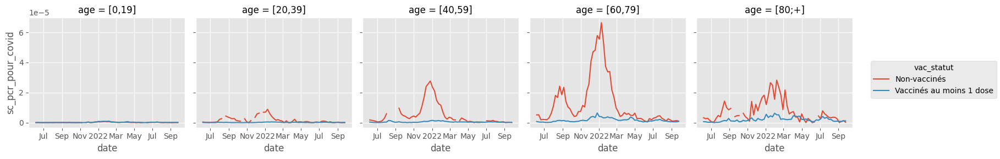

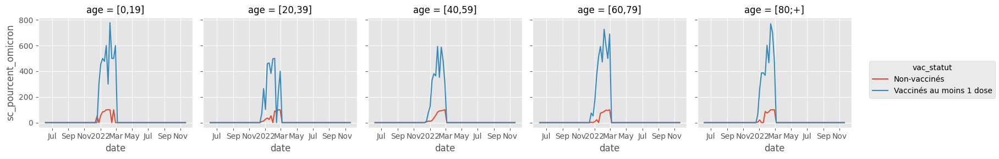

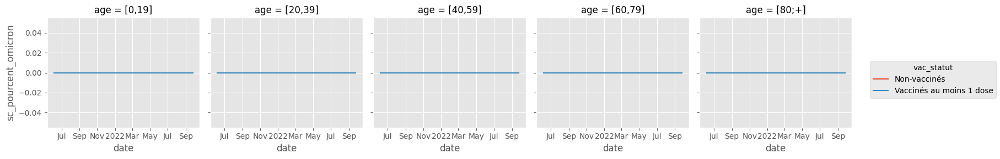

In [40]:
dsp = ds_age_grouped_binary.sel(version="resultats").to_dataset("variable")
dsp2 = ds_age_grouped_normalised_binary.to_dataset("variable")
for variable in list_variables:
    dsp[variable].plot(hue="vac_statut", col="age", sharey=True)
    dsp2[variable].plot(hue="vac_statut", col="age", sharey=True)

#### Sharey = True

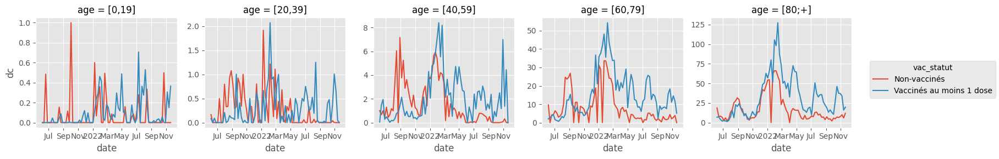

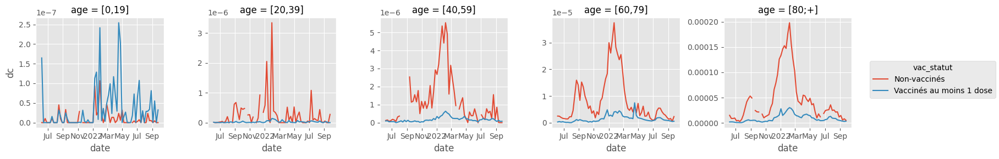

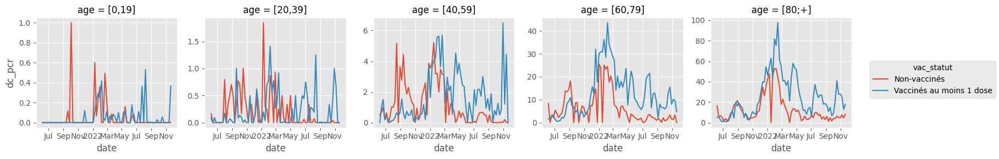

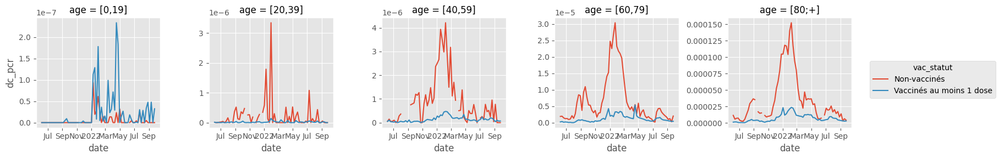

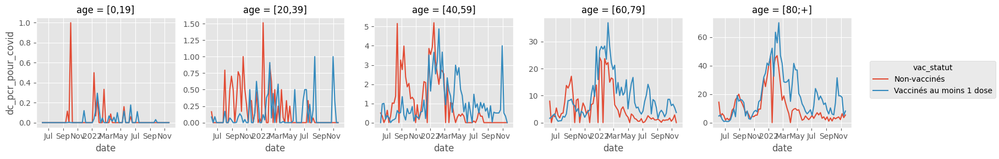

...

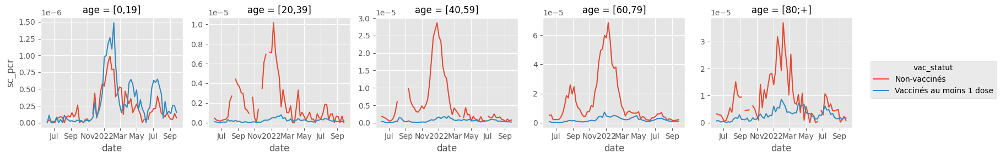

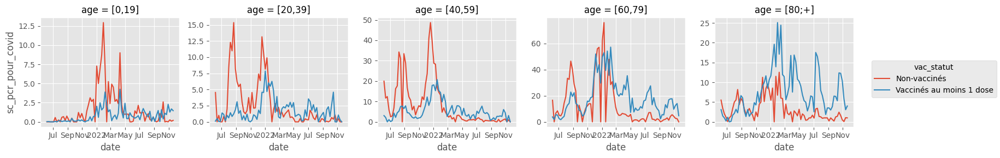

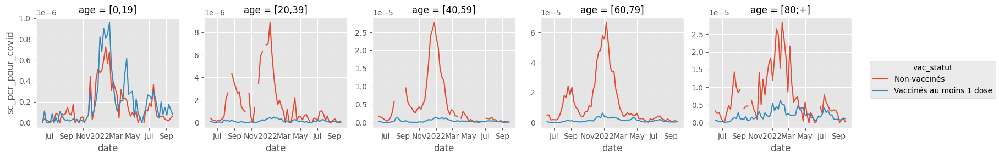

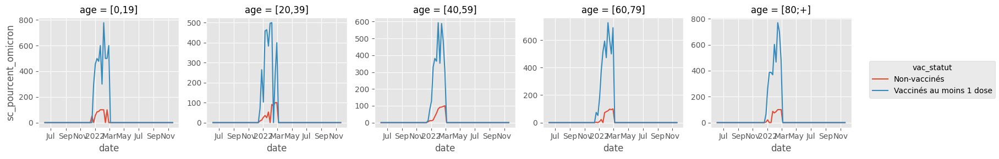

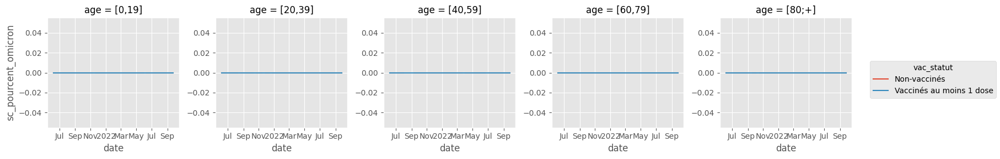

In [41]:
dsp = ds_age_grouped_binary.sel(version="resultats").to_dataset("variable")
dsp2 = ds_age_grouped_normalised_binary.to_dataset("variable")
for variable in list_variables:
    dsp[variable].plot(hue="vac_statut", col="age", sharey=False)
    dsp2[variable].plot(hue="vac_statut", col="age", sharey=False)

## By region

In [42]:
ds_region = xr.load_dataarray("data/ds_by_region.nc")
ds_region = ds_region.resample(date="W").mean()
ds_region_grouped_binary = drees.group_vac_statut(ds_region, binary=True)
ds_age_grouped_normalised_binary = ds_region_grouped_binary.sel(
    version="avant"
) / ds_region_grouped_binary.sel(version="avant").sel(variable="effectif")

In [43]:
ds_region

<xarray.DataArray (version: 3, variable: 17, vac_statut: 17, region: 18,
                   date: 46)>
array([[[[[           nan,            nan,            nan, ...,
           1.16101445e+05, 1.39113983e+05, 1.63934845e+05],
          [           nan,            nan,            nan, ...,
           5.06008050e+04, 6.79826600e+04, 7.56588950e+04],
          [           nan,            nan,            nan, ...,
           5.32538700e+04, 7.16664000e+04, 7.83246450e+04],
          ...,
          [           nan,            nan,            nan, ...,
           8.95811367e+04, 1.18458070e+05, 1.38445627e+05],
          [           nan,            nan,            nan, ...,
           8.35256250e+04, 1.03069635e+05,            nan],
          [           nan,            nan,            nan, ...,
           5.20321050e+04, 6.57604600e+04, 7.51239400e+04]],

         [[           nan,            nan,            nan, ...,
           1.90882097e+06, 1.55984539e+06, 1.29333792e+06],
          [           nan,            nan,            nan, ...,
           6.24219570e+05, 6.09993470e+05, 3.80505805e+05],
          [           nan,            nan,            nan, ...,
           8.94442230e+05, 7.76984705e+05, 5.86940543e+05],
...
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan]],

         [[           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          ...,
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan],
          [           nan,            nan,            nan, ...,
                      nan,            nan,            nan]]]]])
Coordinates:
  * variable    (variable) <U26 'effectif' ... 'sc_pourcent_omicron'
  * vac_statut  (vac_statut) <U50 'Complet - avec 1 rappel de 6 mois ou plus'...
  * region      (region) <U3 'ARA' 'BFC' 'BRE' 'COR' ... 'NOR' 'OCC' 'PAC' 'PDL'
  * version     (version) <U9 'avant' 'resultats' 'anciens'
  * date        (date) datetime64[ns] 2021-06-06 2021-06-13 ... 2022-04-17

- We can see in many regions the underestimation of vaxxed ICU, and overestimation for unvaxxed.

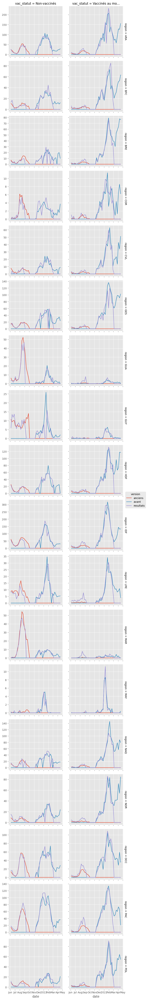

In [44]:
ds_region_grouped_binary.sel(version=["anciens", "avant", "resultats"]).sel(
    variable="hc"
).plot(row="region", hue="version", col="vac_statut", sharey="row")

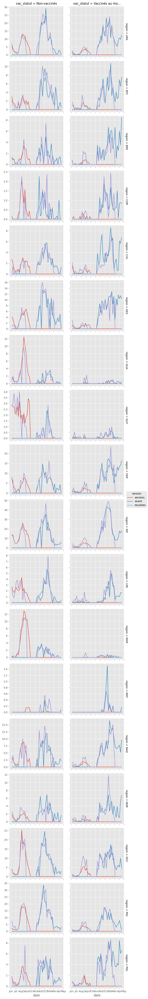

In [45]:
ds_region_grouped_binary.sel(version=["anciens", "avant", "resultats"]).sel(
    variable="sc"
).plot(row="region", hue="version", col="vac_statut", sharey="row")